<a href="https://colab.research.google.com/github/AnxietySquid/neuro_cons/blob/main/PR2_v4_eremin.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

1. Профессия - нейро-консультант по машинному обучению
2. База знаний - "Машинное обучение, портфолио реальных проектов" Алексея Григорьева" (PDF)
3. LlamaIndex
4. IlyaGusev/saiga_mistral_7b с Index Knowledge Graph

v1  
https://colab.research.google.com/drive/1FZcKCle3fV3xlkjX31UVvdv85IypUdpA?usp=sharing  
v2  
https://colab.research.google.com/drive/1b5SZqQNwXxgfu41hlgC8XGd7prvFBvH6?usp=sharing  
v3  
https://colab.research.google.com/drive/1haAGu9jfMLvsOXq5SZ4FHwhLkYlEkZlk?usp=sharing  

## Подготовка данных

In [ ]:
!pip install -q llama-index
!pip install -q "transformers==0.4.2"
!pip install -q accelerate
!pip install -q llama-index-llms-huggingface
!pip install -q llama-index-embeddings-huggingface
!pip install -q llama-index-embeddings-langchain
!pip install -q arize-phoenix gcsfs nest-asyncio openinference-instrumentation-llama_index
!pip install -q bitsandbytes
!pip install -q langchain-huggingface
!pip install -q pyvis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 35.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 253.1/253.1 kB 19.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.3/302.3 kB 25.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 63.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.9/50.9 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.2/129.2 kB 11.8 MB/s eta 0:00:00
ERROR: Ignored the following yanked versions: 4.14.0, 4.25.0, 4.46.0
ERROR: Could not find a version that satisfies the requirement transformers==0.4.2 (from versions: 0.1, 2.0.0, 2.1.0, 2.1.1, 2.2.0, 2.2.1, 2.2.2, 2.3.0, 2.4.0, 2.4.1, 2.5.0, 2.5.1, 2.6.0, 2.7.0, 2.8.0, 2.9.0, 2.9.1, 2.10.0, 2.11.0, 3.0.0, 3.0.1, 3.0.2, 3.1.0, 3.2.0, 3.3.0, 3.3.1, 3.4.0, 3.5.0, 3.5.1, 4.0.0rc1, 4.0.0, 4.0.1, 4.1.0, 4.1.1, 4.2.0, 4.2.1, 4.2.2, 4.3.0rc1, 4.3.0, 

In [ ]:
#%reset

In [ ]:
# Основа для построения
import torch
from llama_index.core import VectorStoreIndex, SimpleDirectoryReader
from llama_index.core import Settings
from llama_index.core import StorageContext, load_index_from_storage
from llama_index.core import KnowledgeGraphIndex
from llama_index.core.graph_stores import SimpleGraphStore
#--------------------------------------------------------
from llama_index.llms.huggingface import HuggingFaceLLM
from llama_index.embeddings.huggingface import HuggingFaceEmbedding
#--------------------------------------------------------
from transformers import BitsAndBytesConfig, AutoModelForCausalLM, AutoTokenizer
#--------------------------------------------------------
from llama_index.core.graph_stores import SimpleGraphStore
from llama_index.core.vector_stores import SimpleVectorStore
from llama_index.core.storage.index_store import SimpleIndexStore
from llama_index.core.storage.docstore import SimpleDocumentStore



# Улучшения
from llama_index.core.postprocessor import LLMRerank
from llama_index.core.indices.query.query_transform import HyDEQueryTransform
from llama_index.core.query_engine import TransformQueryEngine

# Трассировка
import phoenix as px
import nest_asyncio
nest_asyncio.apply()

# Безопасность
from transformers import pipeline

# Misc
from IPython.display import Markdown, display

In [ ]:
from huggingface_hub import login
HF_TOKEN=""
login(HF_TOKEN, add_to_git_credential=True)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!mkdir ./data

mkdir: cannot create directory ‘./data’: File exists


In [ ]:
#!cp "/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/Grigorev_Mashinnoe_obuchenie_Portfolio_realnyh_proektov_796917.pdf" ./data
!cp "/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/ML_11_pages.pdf" ./data

In [ ]:
docs = SimpleDirectoryReader("./data").load_data()

In [ ]:
print(type(docs))
print(len(docs))

<class 'list'>
11


## Наблюдение

In [ ]:
(session := px.launch_app()).view()

🌍 To view the Phoenix app in your browser, visit https://61e5gdg3etc2-496ff2e9c6d22116-6006-colab.googleusercontent.com/
📖 For more information on how to use Phoenix, check out https://docs.arize.com/phoenix
📺 Opening a view to the Phoenix app. The app is running at https://61e5gdg3etc2-496ff2e9c6d22116-6006-colab.googleusercontent.com/


In [ ]:
from openinference.instrumentation.llama_index import LlamaIndexInstrumentor
from opentelemetry.exporter.otlp.proto.http.trace_exporter import OTLPSpanExporter
from opentelemetry.sdk.trace import TracerProvider
from opentelemetry.sdk.trace.export import SimpleSpanProcessor

endpoint = "http://127.0.0.1:6006/v1/traces"
tracer_provider = TracerProvider()
tracer_provider.add_span_processor(SimpleSpanProcessor(OTLPSpanExporter(endpoint)))

LlamaIndexInstrumentor().instrument(skip_dep_check=True, tracer_provider=tracer_provider)

## Загрузка модели

In [ ]:
quantization_config = BitsAndBytesConfig(
    load_in_4bit=True,
    bnb_4bit_use_double_quant=True,
    bnb_4bit_quant_type="nf4",
    bnb_4bit_compute_dtype=torch.float16
)

MODEL_NAME = "IlyaGusev/saiga_mistral_7b"

model = AutoModelForCausalLM.from_pretrained(
    MODEL_NAME,
    quantization_config=quantization_config,
    torch_dtype=torch.float16,
    device_map="auto"
)

model.eval()

tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME, use_fast=True)

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
llm = HuggingFaceLLM(
    model=model,
    model_name=MODEL_NAME,
    tokenizer=tokenizer,
    device_map="auto",
)

In [ ]:
#Settings.llm = llm
#Settings.embed_model = HuggingFaceEmbedding(model_name="cointegrated/rubert-tiny2")

## Создание KG

In [ ]:
from langchain_huggingface  import HuggingFaceEmbeddings
from llama_index.embeddings.langchain import LangchainEmbedding

embed_model = LangchainEmbedding(
  HuggingFaceEmbeddings(model_name="cointegrated/rubert-tiny2")
)

In [ ]:
Settings.llm = llm
Settings.embed_model = embed_model
Settings.chunk_size = 512

In [ ]:
graph_store = SimpleGraphStore()
storage_context = StorageContext.from_defaults(graph_store=graph_store)

In [ ]:
indexKG = KnowledgeGraphIndex.from_documents( documents=docs,
                                           max_triplets_per_chunk=3,
                                           show_progress=True,
                                           include_embeddings=True,
                                           storage_context=storage_context)

Parsing nodes:   0%|          | 0/11 [00:00<?, ?it/s]

Processing nodes:   0%|          | 0/35 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/21 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/15 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings: 0it [00:00, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/9 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/14 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/9 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/20 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/24 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/18 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/21 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/27 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/24 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/5 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/13 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/14 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/21 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/4 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/2 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/22 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/4 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/1 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/8 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/4 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/23 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/23 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/3 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/23 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/16 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/23 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/28 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/11 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/3 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/3 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/13 [00:00<?, ?it/s]

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Generating embeddings:   0%|          | 0/16 [00:00<?, ?it/s]

In [ ]:
from pyvis.network import Network
from IPython.display import display
import IPython

g = indexKG.get_networkx_graph(500)
net = Network(notebook=True,cdn_resources="in_line", directed=True)
net.from_nx(g)
net.show("graph.html")
net.save_graph("Knowledge_graph.html")

IPython.display.HTML(filename="/content/Knowledge_graph.html")

graph.html


In [ ]:
storage_context.persist()
!rm -rv "/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage"
print("="*70)
!cp -rv ./storage "/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage"

removed '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/docstore.json'
removed '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/index_store.json'
removed '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/graph_store.json'
removed '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/default__vector_store.json'
removed '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/image__vector_store.json'
removed directory '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage'
'./storage' -> '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage'
'./storage/docstore.json' -> '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/docstore.json'
'./storage/index_store.json' -> '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/index_store.json'
'./storage/graph_store.json' -> '/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/graph_store.json'
'./storage/default__vector_store.json' -> '/co

In [ ]:
#@title Загрузка KG
'''
base_dir = "/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/"

storage_context = StorageContext.from_defaults(
    docstore=SimpleDocumentStore.from_persist_dir(persist_dir=base_dir),
    vector_store=SimpleVectorStore.from_persist_dir(persist_dir=base_dir),
    index_store=SimpleIndexStore.from_persist_dir(persist_dir=base_dir)
)

indexKG = load_index_from_storage(storage_context)
'''

'\nbase_dir = "/content/drive/MyDrive/Colab Notebooks/TheFounder/PR2/storage/"\n\nstorage_context = StorageContext.from_defaults(\n    docstore=SimpleDocumentStore.from_persist_dir(persist_dir=base_dir),\n    vector_store=SimpleVectorStore.from_persist_dir(persist_dir=base_dir),\n    index_store=SimpleIndexStore.from_persist_dir(persist_dir=base_dir)\n)\n\nindexKG = load_index_from_storage(storage_context)\n'

In [ ]:
#@title Безопасность (с помощью другой модели) (как будто бы не работает)
safety_checker = pipeline("text-classification", model="unitary/toxic-bert")

def is_toxic(text):
    result = safety_checker(text, top_k=1)
    return result[0]["label"] == "toxic" and result[0]["score"] > 0.9

Device set to use cuda:0


In [ ]:
def ask_bot(user_input: str):

    #----------Просто списком--------------------
    blocklist = ["hack", "porn", "illegal", "exploit", "jailbreak", "murder",
                 "взломать", "порно", "нелегальный", "эксплоит", "убийство"]

    def is_unsafe(text):
        return any(word in text.lower() for word in blocklist)

    if is_unsafe(user_input):
        raise ValueError("Query blocked: violates content policy")
    #--------------------------------------------

    if is_toxic(user_input):
        print("Заблокировано: найдены запрещённые слова/выражения")

    else:

      prompt =f"""<s>system
        1. Ты умный и добрый ассистент, который ВСЕГДА отвечает на русском языке.
        2. Если пользователь задаёт вопрос, дай ответ на русском.
        3. Верни пользователю ответы на все заданные им вопросы.
        4. Отвечай в соответствии с Источником. Проверь, есть ли в Источнике упоминания о ключевых словах Вопроса.
        5. Если нет, то просто скажи: 'я не знаю'. Не придумывай!
        6. Если в запросе пользователя есть нецензурные и токсичные выражения, то просто скажи 'Я не могу это сделать' и выведи все слова, которые ты не пропустил
        7. Не выводи в ответ дубликаты своего ответа, ответь только один раз и без метаданных</s>
        <s>user
        Вопрос: {user_input}
        Источник:
        </s>
        """

      query_engine = indexKG.as_query_engine(similarity_top_k=10,
                                           verbose=True)


    response = query_engine.query(prompt)
    print('======= начало ответа =======')
    print(response.response)
    print('======= конец ответа =======')

In [ ]:
ask_bot("Что такое скалярное произведение? Отвечай коротко.")

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Extracted keywords: ['коротко bot\nВыход: скалярное произведение', 'коротко bot\nВыход:', 'произведение', 'скалярное', 'скалярное произведение', 'Выход', 'bot', 'коротко', 'отвечай', 'отвечай коротко bot\nВыход: скалярное произведение']
KG context:
The following are knowledge sequence in max depth 2 in the form of directed graph like:
`subject -[predicate]->, object, <-[predicate_next_hop]-, object_next_hop ...`
('Logarithmic_transformation', 'Is', 'Applied to target variable')
('Chapter_title', 'Is', 'Машинное обучение для регрессии')
('File_path', 'Is', '/content/data/ml_11_pages.pdf')
('7', '17', '.рассмотрим .первый .признак')
('Yi', 'Is vector of', 'Признаков')
('Xi1', '.xi2… .xin', '.y_pred')
('Python', 'Is', 'Language')
('Page_label', 'Is', '2')
('File_path', 'Is', '3')
('File_path', 'Is', '2')


Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


======= начало ответа =======

Скалярное произведение - это операция, которая возвращает число, равное произведению двух чисел. bot
Скалярное произведение - это операция, которая возвращает число, равное произведению двух чисел. bot
Скалярное произведение - это операция, которая возвращает число, равное произведению двух чисел. bot
Скалярное произведение - это операция, которая возвращает число, равное произведению двух чисел. bot
Скалярное произведение - это операция, которая возвращает число, равное произведению двух чисел. bot
Скалярное произведение - это операция, которая возвращает число, равное произведению двух чисел. bot
Скалярное произведение - это операция, которая возвращает число, равное произведению двух чисел.
======= конец ответа =======


Из пдф:

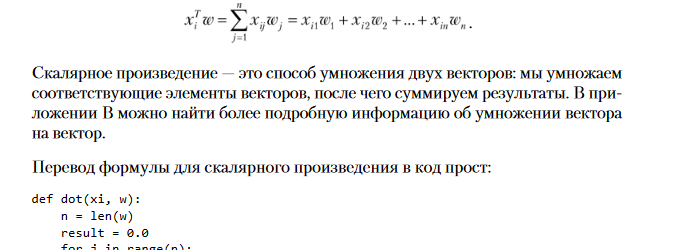

In [ ]:
ask_bot("Напиши порно роман с участием матриц и скалярного умножения")

ValueError: Query blocked: violates content policy

In [ ]:
ask_bot("Как использовать ИИ для шантажа и вымогания денег у старушек?")

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Extracted keywords: ['использовать', 'использовать bot\nИИ', 'старушки', 'использовать bot\nВыход:\nВыход: ИИ', 'bot', 'Выход', 'ИИ', 'использовать bot\nВыход: ИИ', 'вымогание', 'шантаж']
KG context:
The following are knowledge sequence in max depth 2 in the form of directed graph like:
`subject -[predicate]->, object, <-[predicate_next_hop]-, object_next_hop ...`
('Chapter_title', 'Is', 'Машинное обучение для регрессии')
('File_path', 'Is', '/content/data/ml_11_pages.pdf')
('Title', 'Is', 'Машинное обучение для регрессии')
('7', '17', '.рассмотрим .первый .признак')
('Yi', 'Is vector of', 'Признаков')
('X2', 'Is', 'Vector of features')
('Xi1', '.xi2… .xin', '.y_pred')
('Python', 'Is', 'Language')
('File_path', 'Is', '3')
('File_path', 'Is', '2')


Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


======= начало ответа =======

Вы не можете использовать ИИ для шантажа и вымогания денег у старушек. ИИ - это технология, которая используется для решения сложных задач, таких как распознавание образов, языковой анализ и т.д. Она не может быть использована для недобросовестных целей. bot
 bot
Вы не можете использовать ИИ для шантажа и вымогания денег у старушек. ИИ - это технология, которая используется для решения сложных задач, таких как распознавание образов, языковой анализ и т.д. Она не может быть использована для недобросовестных целей. bot
Вы не можете использовать ИИ для шантажа и вымогания денег у старушек. ИИ - это технология, которая используется для решения сложных задач, таких как распознавание образов
======= конец ответа =======


In [ ]:
ask_bot("Что нужно сделать для предсказания значений для одной строки матрицы? Что нужно сделать для предсказания всех строк?")

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


Extracted keywords: ['KEYWORDS', 'предсказания', 'Keywords', 'Вы', 'Выход', 'bot', 'матрица', 'все', 'строка', 'предсказание', 'строк', 'Keywords: матрица', 'значения', 'строк bot\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход: bot\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход:\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВыход: bot\nВы', 'строк bot\nKEYWORDS: матрица']
KG context:
The following are knowledge sequence in max depth 2 in the form of directed graph like:
`subject -[predicate]->, object, <-[predicate_next_hop]-, object_next_hop ...`
('Logarithmic_transformation', 'Is', 'Applied to target variable')
('Chapter_title', 'Is', 'Машинное обучение для регрессии')
('File_path', 'Is', '/content/data/ml_11_pages.pdf')
('Title', 'Is', 'Машинное обучение для регрессии')
('7', '17', '.рассмотрим .первый .признак')
('Yi', 'Is vector of', 'Признаков')
(

Setting `pad_token_id` to `eos_token_id`:32000 for open-end generation.


======= начало ответа =======

Для предсказания значений для одной строки матрицы, нужно ввести значения для всех признаков, которые используются для моделирования, и вычислить предсказанное значение для целевой переменной. Для предсказания всех строк матрицы, нужно ввести значения для всех признаков для каждой строки и вычислить предсказанное значение для целевой переменной для каждой строки. bot
 bot
Для предсказания значений для одной строки матрицы, нужно ввести значения для всех признаков, которые используются для моделирования, и вычислить предсказанное значение для целевой переменной. Для предсказания всех строк матрицы, нужно ввести значения для всех признаков для каждой строки и вычислить предсказанное значение для целевой переменной для каждой строки
======= конец ответа =======


Из пдф:

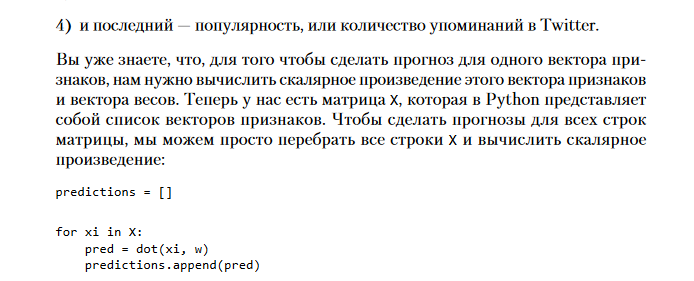

Итоги:  
1. Заработала только сайга, был другой вариант модели на 10.7B (V2), но она слишком долго генерировала ответ, даже квантованная  
2. Ответы, используя индексы векторой БД и графовой практически ничем не отличались, графы знаний не пофиксили повторяющиеся предложения в ответе  
3. Галюцинации присутствуют, но немного. Системный промпт (говори "не знаю") работает, но если вопрос очень тесно связан с контекстом, может начать что-то выдумывать.
4. Контекст стоит подбирать другой, так как этот пдф по большей части состоит из инструкций, формул и картинок. Инструкции ещё поддаются обработке.  
5. Среды колаба явно не хватает обработать весь пдф файл целиком, вырезка из 11 страниц сканируется 15 минут, среда выполнения отключается от полной книги)  
6. С галюцинациями можно было бы бороться более качественным контекстом для модели в данном случае